In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, RepeatedKFold, cross_validate
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, ConfusionMatrixDisplay, f1_score
from sklearn.decomposition import PCA
from sklearn.base import BaseEstimator
from scipy import stats

sns.set_style('ticks')

%matplotlib inline
%load_ext autoreload
%autoreload 2

# Завдання

## 1. Огляд даних 

### 1.1 Про що дані

У цьому індивідуальному завданні я використовую той самий датасет, що в лабораторній роботі №5. Це дані про пісні із стримінгового сервісу [Spotify](https://open.spotify.com/). Про кожну пісню ми, окрім її назви та автора, знаємо низку показників як от популярність, акустичність, інструментальність ітд.

Завдання класифікації полягає в тому щоб класифікувати до якого, з 10 жанрів, належить пісня: `'Electronic', 'Anime', 'Jazz', 'Alternative', 'Country', 'Rap', 'Blues', 'Rock', 'Classical', 'Hip-Hop'`.

Дані можна знайти [тут](https://www.kaggle.com/datasets/vicsuperman/prediction-of-music-genre)

In [2]:
df = pd.read_csv('music_genre.csv')
df.head()

,instance_id,artist_name,track_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
0,32894.0,Röyksopp,Röyksopp's Night Out,27.0,0.00468,0.652,-1.0,0.941,0.79200,A#,0.115,-5.201,Minor,0.0748,100.889,4-Apr,0.759,Electronic
1,46652.0,Thievery Corporation,The Shining Path,31.0,0.01270,0.622,218293.0,0.890,0.95000,D,0.124,-7.043,Minor,0.0300,115.00200000000001,4-Apr,0.531,Electronic
2,30097.0,Dillon Francis,Hurricane,28.0,0.00306,0.620,215613.0,0.755,0.01180,G#,0.534,-4.617,Major,0.0345,127.994,4-Apr,0.333,Electronic
3,62177.0,Dubloadz,Nitro,34.0,0.02540,0.774,166875.0,0.700,0.00253,C#,0.157,-4.498,Major,0.2390,128.014,4-Apr,0.270,Electronic
4,24907.0,What So Not,Divide & Conquer,32.0,0.00465,0.638,222369.0,0.587,0.90900,F#,0.157,-6.266,Major,0.0413,145.036,4-Apr,0.323,Electronic


### 1.2 Перевірка типів/пропущених значень 

Як можемо побачити, маємо 5 пустих рядків

In [3]:
# check for nan values
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50005 entries, 0 to 50004
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   instance_id       50000 non-null  float64
 1   artist_name       50000 non-null  object 
 2   track_name        50000 non-null  object 
 3   popularity        50000 non-null  float64
 4   acousticness      50000 non-null  float64
 5   danceability      50000 non-null  float64
 6   duration_ms       50000 non-null  float64
 7   energy            50000 non-null  float64
 8   instrumentalness  50000 non-null  float64
 9   key               50000 non-null  object 
 10  liveness          50000 non-null  float64
 11  loudness          50000 non-null  float64
 12  mode              50000 non-null  object 
 13  speechiness       50000 non-null  float64
 14  tempo             50000 non-null  object 
 15  obtained_date     50000 non-null  object 
 16  valence           50000 non-null  float6

Деякі пісні мають тривалість `-1`

In [4]:
# check duration column
df['duration_ms'].head()

0        -1.0
1    218293.0
2    215613.0
3    166875.0
4    222369.0
Name: duration_ms, dtype: float64

Для деяких пісень невідомий темп

In [5]:
df[df['tempo'] == '?'].tempo.head()

5     ?
32    ?
35    ?
36    ?
39    ?
Name: tempo, dtype: object

### 1.3 Виправелення знайдених недоліків

In [6]:
# drop unneeded columns
cols = ['instance_id', 'artist_name', 'track_name', 'obtained_date', 'popularity', 'key']
df.drop(cols, axis=1, inplace=True)

# remove rows with nan values
df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True)

# convert mode to numerical column
df['mode'] = df['mode'].replace({'Minor': 0, 'Major': 1})

# replace missing values in duration and tempo columns
# with a mean value in this column
duration_mean = df.loc[df['duration_ms'] != -1, 'duration_ms'].mean()
df['duration_ms'].replace(-1, duration_mean, inplace=True)

df['tempo'] = df['tempo'].replace('?', np.nan).astype(float)
df['tempo'].fillna(df['tempo'].mean(), inplace=True)

# convert target column to categorical
df['music_genre'] = df['music_genre'].astype('category')
# create numeric targets
df['genre_num'] = df['music_genre'].cat.codes

Ось так виглядатиме `DataFrame` після препроцисінгу:

In [7]:
df.head()

,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,mode,speechiness,tempo,valence,music_genre,genre_num
0,0.00468,0.652,245503.541466,0.941,0.79200,0.115,-5.201,0,0.0748,100.889,0.759,Electronic,5
1,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0,0.0300,115.002,0.531,Electronic,5
2,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,1,0.0345,127.994,0.333,Electronic,5
3,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,1,0.2390,128.014,0.270,Electronic,5
4,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,1,0.0413,145.036,0.323,Electronic,5


## 2. Візуалізації

Візуалізацію для цих даних я робив в Індивідуальному Завданні №1. Графіки можна переглянути [тут](https://public.tableau.com/views/SpotifyMusicGenres_16668239707930/SpotifyMusicGenres?:language=en-US&:display_count=n&:origin=viz_share_link).

Нижче наведу тільки ключові візуалізації

### 2.1 Матриця розсіювання

Графік не є надто інформативним, оскільки таблиця містить багато значень, проте дає змогу швидко оглянути глобальну картину.

З такого графіку не зрозуміти, як характеристики пісні впливають на її належність до певного жанру, проте можна побачити як пов'язані характеристики між собою.  
Ми чітко можемо побачити негативну кореляцію між стовпчиками `loudness - acousticness` та позитивну кореляцію між стовпчиками `loundess - energy`.

In [8]:
params = {'axes.labelsize': 48, 'xtick.labelsize': 32, 'ytick.labelsize': 32}
with sns.plotting_context(params):
    sns.pairplot(df, height=7);

### 2.2 Розподіл класів

Ми маємо однакову кількість семплів для кожного класу, іншими словами, вирішуємо завдання збалансованої класифікації. Це дає нам змогу покладатись на такі метрики як, наприклад, точність.

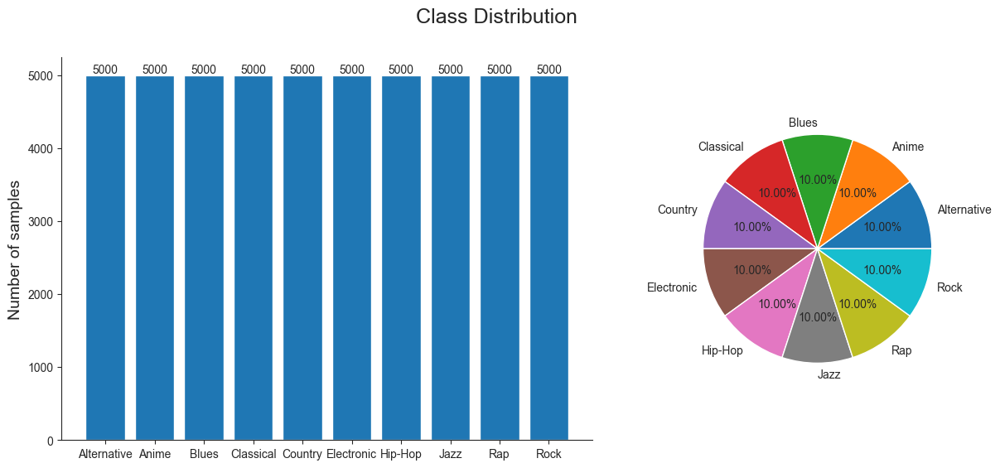

In [9]:
class_count = df['music_genre'].value_counts() 
labels = df['music_genre'].cat.categories
fig, ax = plt.subplots(1, 2,  gridspec_kw={'width_ratios': [2.6, 1.4]}, figsize=(14, 6))
fig.suptitle('Class Distribution', fontsize=18)
container = ax[0].bar(labels, class_count)
ax[0].bar_label(container)
ax[0].set_ylabel('Number of samples', fontsize=14)

ax[1].pie(class_count, labels=labels, autopct='%.2f%%')
sns.despine();

## 3. Статистичні тести

Кілька слів про те, як ми проводитимемо тести:
- На першому кроці ми маємо сформулювати гіпотези стосовно даних. Таких гіпотез має бути 2, і вони мають бути взаємовиключні, тобто якщо справджується нульова, перша виконуватись не може, і навпаки.
- Далі потрібно провести статистичний тест (критерій), який допомагає перевірити гіпотези. З результатів цього тесту нас цікавитиме такий показник як p-значення (`p-value`).
- p-значення - це імовірність, отримати результат тесту, якщо нульова гіпотеза справджується.
- Залишається тільки правильно інтерпретувати цю ймовірність. Перед початком експерименту, ми маємо встановити поріг $\alpha$ (в тестах нижче $\alpha=0.05$). Якщо $p-value<\alpha$ (тобто ймовірність, що нульова гіпотеза справджується менша ніж 5%) результат вважається статистично значущим, і ми можемо відхилити нульову гіпотезу.  
Якщо $p-value\geq\alpha$ ми **не можемо** відхилити першу гіпотезу. Це говорить лише про те, що у нас недостатньо доказів щоб перевірити гіпотези і потрібно перевиконати тест в інших умовах.

### 3.1 Критерій Узгодженості Колмогова-Смірнова

Цей тест перевіряє чи 2 стовпці підпорядковуються одному закону розподілу (в нашому випадку в якості 2-го стовпчика будемо брати нормальний розподіл). Для нас це важливо, щоб розуміти які статистичні тести застосовувати в подальшому, параметричні чи непараметричні.

$$H_0 = Gaussian\;Distribution$$
$$H_1 = Not\; Gaussian\; Distribution$$

In [10]:
# calculate p-values
p_values = {column: stats.kstest(df[column], 'norm').pvalue
            for column in df.columns if column != 'music_genre'}
for col, p in sorted(p_values.items()):
    print(f'{col:<18}: {p}')

acousticness      : 0.0
danceability      : 0.0
duration_ms       : 0.0
energy            : 0.0
genre_num         : 0.0
instrumentalness  : 0.0
liveness          : 0.0
loudness          : 0.0
mode              : 0.0
speechiness       : 0.0
tempo             : 0.0
valence           : 0.0


Як можемо побачити, для всіх стовпчиків p-значення < 0.05 - це означає, що жоден із стовпців не має нормального розподілу. Отже, маємо застосовувати непараметричні тести. 

### 3.2 Коефіцієнт кореляції Спірмена

Коефіцієнт кореляції Спірмена - міра залежності між двома змінними. Коефіцієнт кореляції Спірмена рекомендують використовувати, коли ми не впевнені про розподіл змінних.
$$H_0=Two\;Sets\;of\;Data\;are\;Uncorrelated$$
$$H_1=There\;is\;Some\;Correlation\;Between\;Two\;Sets\;of\;Data$$

In [11]:
p_values = {}
for column in df.columns:
    if column in {'music_genre', 'genre_num'}:
        continue
    r, p = stats.spearmanr(df[column], df['genre_num'])
    p_values.update({column: (abs(r), p)})

for col, (r, p) in sorted(p_values.items(), key=lambda x: x[1], reverse=True):
    print(f'{col:<18}: Corr = {r}; p-value = {p} (p <= 0.05 --> {p <= 0.05})')

danceability      : Corr = 0.3047259521880751; p-value = 0.0 (p <= 0.05 --> True)
instrumentalness  : Corr = 0.15323328056655494; p-value = 2.5162596828028847e-260 (p <= 0.05 --> True)
speechiness       : Corr = 0.14952756610326687; p-value = 7.550516203604398e-248 (p <= 0.05 --> True)
valence           : Corr = 0.07514423793625849; p-value = 1.570248987815223e-63 (p <= 0.05 --> True)
mode              : Corr = 0.0398322890033517; p-value = 5.099401866010903e-19 (p <= 0.05 --> True)
duration_ms       : Corr = 0.029918545554059144; p-value = 2.2116538733385105e-11 (p <= 0.05 --> True)
acousticness      : Corr = 0.025594752160379798; p-value = 1.0407226683074528e-08 (p <= 0.05 --> True)
loudness          : Corr = 0.024870379065279974; p-value = 2.6684248345522208e-08 (p <= 0.05 --> True)
tempo             : Corr = 0.016723835420730002; p-value = 0.00018421706628635791 (p <= 0.05 --> True)
liveness          : Corr = 0.0146232867360889; p-value = 0.0010756292294601963 (p <= 0.05 --> True)


### 3.3 Feature Importance використовуючи Random Forest

Окрім статистичних тестів, ми також можемо використати `Random Forest`, щоб дізнатись найбільш корисні для нас показники.  
Ідея проста, ми навчаємо `Random Forest` на всіх даних які в нас є, а потім для кожного стовпця обраховуємо його `importance`, як величину, на яку він зменшує `Gini Impurity` в конкретній ноді дерева, множену на вірогідність потрапити на цю ноду.  
В `sklearn` отримані значення нормалізовані, тобто сумуються в одиницю.

In [12]:
X = df.drop(['music_genre', 'genre_num'], axis='columns')
y = df['genre_num']

model = RandomForestClassifier(random_state=42)
model.fit(X, y)
importance = model.feature_importances_

imp_dict = {df.columns[col_idx]: imp for col_idx, imp in enumerate(importance)}
imp_dict = dict(sorted(imp_dict.items(), key=lambda x: x[1], reverse=True))
for col, imp in imp_dict.items():
    print(f'{col:<18}: Importance = {imp}')

loudness          : Importance = 0.11536605649019616
speechiness       : Importance = 0.11106569993737307
acousticness      : Importance = 0.11067066091063422
danceability      : Importance = 0.11032918792354336
instrumentalness  : Importance = 0.10128711137019022
energy            : Importance = 0.09974499842199529
duration_ms       : Importance = 0.09430129886738116
valence           : Importance = 0.09176868252508735
tempo             : Importance = 0.08061184793939996
liveness          : Importance = 0.07119553780753106
mode              : Importance = 0.013658917806668306


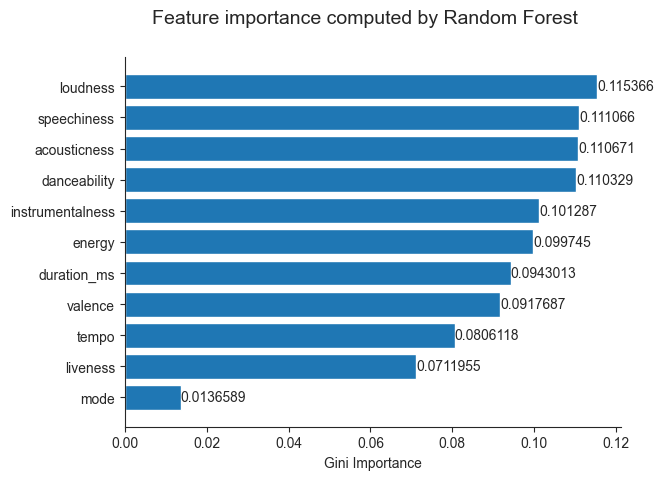

In [13]:
plt.suptitle('Feature importance computed by Random Forest', fontsize=14)
container = plt.barh(list(imp_dict)[::-1], list(imp_dict.values())[::-1])
plt.bar_label(container)
plt.xlabel('Gini Importance')
sns.despine();

### Результати

З огляду на проведені тести, для подальшого тренування я оберу 4 стовпці які мали найбільшу кореляцію в коефіцієнті Спірмена (`danceability, speechiness, instrumentalness, valence`) та додам кілька стовпців які вважає корисними `Random Forest` (`loudness, acousticness, energy`).  
Від себе додам стовпець `duration_ms`, тому що з візуалізацій в інд. завданні ми бачили, що по ньому можна гарно відрізнити, наприклад, жанр класичної музики.

## 4. Підготовка даних до тренування

In [14]:
cols_to_drop = ['mode', 'liveness', 'tempo', 'music_genre']
train_df = df.drop(cols_to_drop, axis='columns')

In [15]:
train_df.head()

,acousticness,danceability,duration_ms,energy,instrumentalness,loudness,speechiness,valence,genre_num
0,0.00468,0.652,245503.541466,0.941,0.79200,-5.201,0.0748,0.759,5
1,0.01270,0.622,218293.000000,0.890,0.95000,-7.043,0.0300,0.531,5
2,0.00306,0.620,215613.000000,0.755,0.01180,-4.617,0.0345,0.333,5
3,0.02540,0.774,166875.000000,0.700,0.00253,-4.498,0.2390,0.270,5
4,0.00465,0.638,222369.000000,0.587,0.90900,-6.266,0.0413,0.323,5


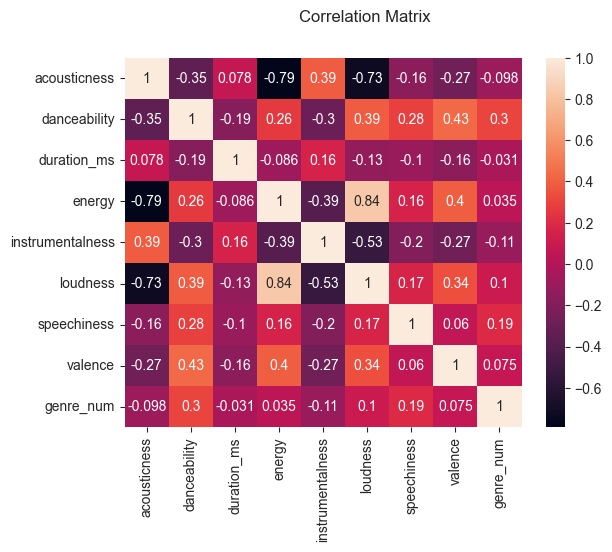

In [16]:
plt.suptitle('Correlation Matrix')
sns.heatmap(train_df.corr(), annot=True);

In [17]:
X = train_df.drop('genre_num', axis='columns')
y = train_df['genre_num']

# normalize data
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=X.columns, index=X.index)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

## 5. Код для тренування моделей

In [18]:
class TestClassifier(BaseEstimator):
    """
    A custom class that allows us to perform training of different models
    """
    def __init__(self, classifier, y_test):
        self._classifier = classifier
        self._y_test = y_test
        self.model_name = type(self._classifier).__name__
    
    def fit(self, x_train, y_train):
        self._classifier.fit(x_train, y_train)
        return self
    
    def predict(self, x_test):
        """
        Returns predictions made by the passed classifier
        """
        return self._classifier.predict(x_test)
    
    def test_scores(self, predictions):
        accuracy = accuracy_score(self._y_test, predictions)
        f1 = f1_score(self._y_test, predictions, average='macro')
        return accuracy, f1
    
    def plot_cm(self, predictions, class_names):
        """Plot Confusion matrix"""
        fig, ax = plt.subplots(1, 1)
        ax.set_title(f'Confusion Matrix for {self.model_name}')
        ConfusionMatrixDisplay.from_predictions(self._y_test, predictions, ax=ax,
                                                display_labels=class_names, xticks_rotation='vertical')
        plt.show()

## 6. Тренування Моделей 

Test results for LogisticRegression:
------------------------------------------------------------------------------
Test Accuracy: 0.3913
Test F1-Score: 0.3817616522185587


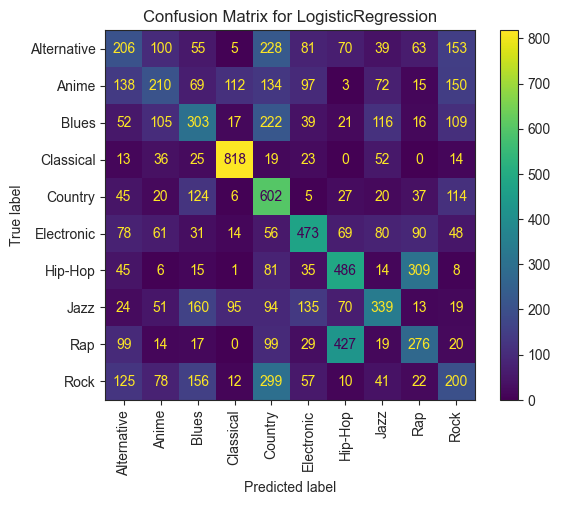

Test results for DecisionTreeClassifier:
------------------------------------------------------------------------------
Test Accuracy: 0.4164
Test F1-Score: 0.40303573658747427


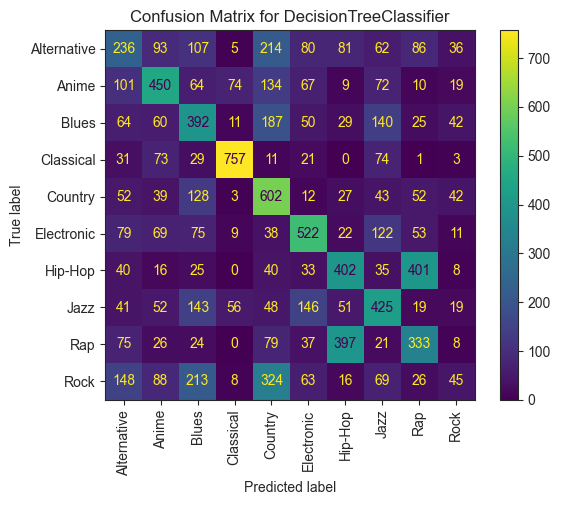

Test results for RandomForestClassifier:
------------------------------------------------------------------------------
Test Accuracy: 0.4519
Test F1-Score: 0.4273379501113421


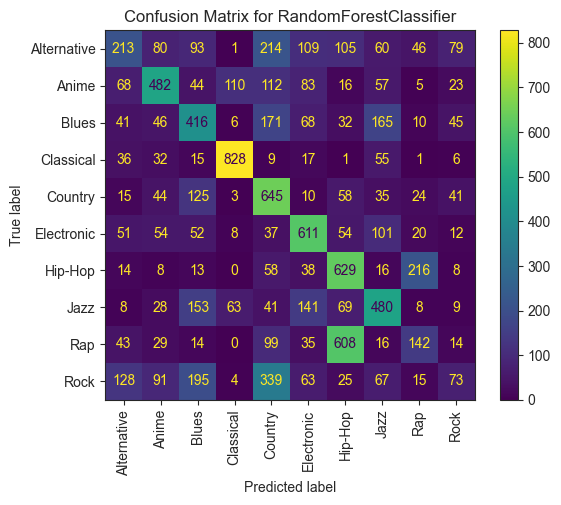

In [19]:
class_names = list(df['music_genre'].cat.categories)

models = [
              LogisticRegression(random_state=42),
              DecisionTreeClassifier(max_depth=10, random_state=42), 
              RandomForestClassifier(max_depth=10, random_state=42)
         ]

model_comparison = {}

# iterating over list of models, performing equal training for each
for model in models:
    test_model = TestClassifier(model, y_test)
    test_model.fit(X_train, y_train)
    predictions = test_model.predict(X_test)
    test_acc, test_f1 = test_model.test_scores(predictions)
    print(f'Test results for {test_model.model_name}:')
    print('------------------------------------------------------------------------------')
    print(f'Test Accuracy: {test_acc}')
    print(f'Test F1-Score: {test_f1}')
    
    model_comparison.update({test_model.model_name: (test_acc, test_f1)})
    
    test_model.plot_cm(predictions, class_names)

## 7. Результати тренування

In [20]:
# create data frame that will contain all our test results
result = pd.DataFrame.from_dict(model_comparison, orient='index', columns=['Accuracy', 'F1-Score'])
# data frame with models sorted by 'PR AUC'
by_pr = result.sort_values(by='Accuracy', ascending=False)
by_pr.style.set_caption('Models Sorted by Accuracy')

,Accuracy,F1-Score
RandomForestClassifier,0.451900,0.427338
DecisionTreeClassifier,0.416400,0.403036
LogisticRegression,0.391300,0.381762


В таблиці вище наведено метрики для 3 моделей. Отримані мною значення майже ідентичні до тих, що вдалось досягти в 6 лабораторній роботі.  

В попередній роботі я стверджував, що ці дані є не найкращим прикладом для класифікації. Задача досить складна, оскільки музичні жанри мають багато спільного, і наведені в датасеті показники не дають можливість повноцінно відрізнити один жанр від іншого.  
Якщо звернути увагу на матриці невідповідностей, то більш менш гарно нам вдалось класифікувати лише класичний жанр (828 правильно класифікованих треків із 1000 представлених в тестовий вибірці), оскільки він сильно виділяється на фоні інших. Припускаю, що в цьому допомагає стовпчик `duration_ms`, який був доданий мною для тренування.   

В цілому, мій `EDA` не підвищив метрики, проте й не зробив гірше. Можна зробити висновок, що тренування моделі на повному наборі стовпців (те що я зробив в роботі 6) не призводить до втрати точності. Цим аналізом я швидше знайшов не ті стовпці, які можуть дати нам приріст метрик, а ті, які абсолютно на них не впливають, тим самим трохи оптимізувавши обчислення. 